# Music to Guitar Tab Transcriber

This Collab Notebook lays out the steps to convert an isolated guitar track from Youtube to Guitar Tabs and evaluate generated tabs.

## The Why?

Guitar tabs are a relatively easy way to represent music primarily music played on a guitar or similar stringed instrument. Sheet notation is what is formally used in a lot of settings but reading sheet music isn't exactly the easiest. Guitar tabs have won the hearts and minds of a lot of people.

- Easier to read, learn and comprehend
- More specific in some contexts
- Playable formats exist that make learning and comprehending even easier


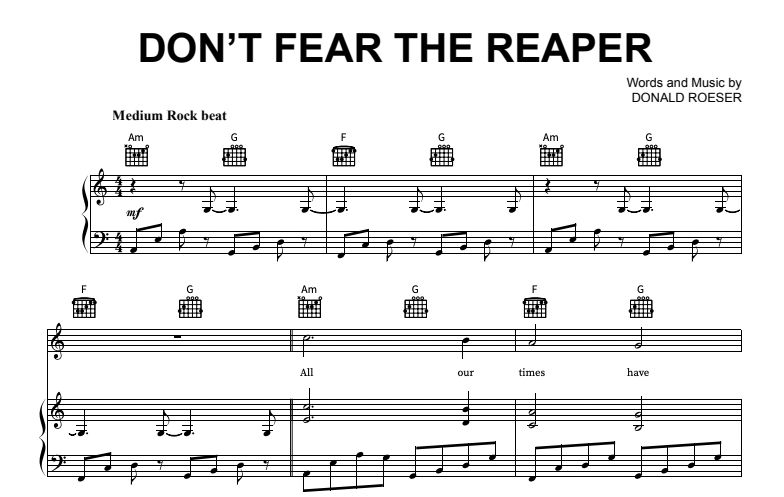

Compare that to Guitar tabs below

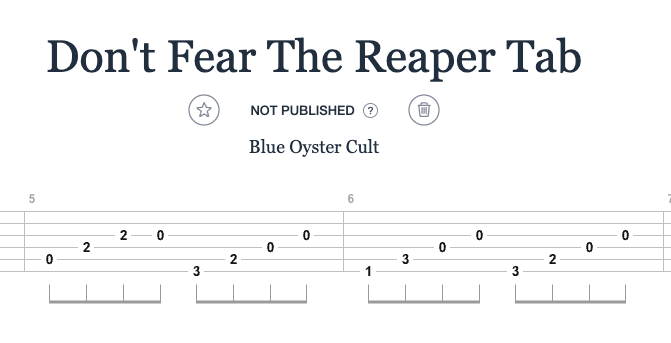

So we now have a readable or easier format to deal with but there's a problem. Creating guitar tabs (or sheet music for that matter) is no easy task. There are experts and transcribing music is a huge part of the learning process but finding transcriptions for songs you like becomes a hard task when you look for less popular or more niche music. The quality of tabs also vary.

The best and accurate tabs are usually done by musicians who do it professionally and this in turns takes time and money. So a niche piece of music or even more technical music is even harder to find and transcribe. This is a problem that AI and ML can help solve.

## Pipeline

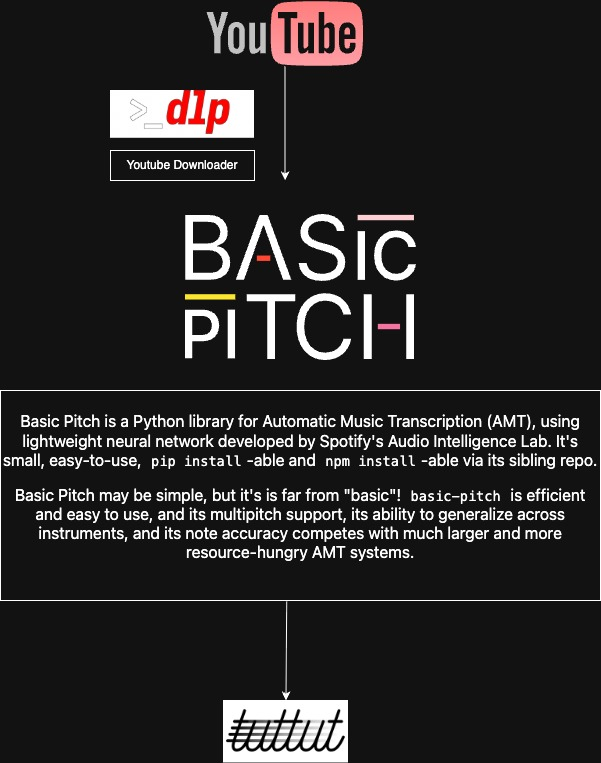

## Environment Setup

In [2]:
!python -V
!pip -V

zsh:1: command not found: python
zsh:1: command not found: pip


In [ ]:
# prompt: conda environment in this notebook to use python 3.9

! wget https://repo.anaconda.com/miniconda/Miniconda3-py39_4.12.0-Linux-x86_64.sh
! chmod +x Miniconda3-py39_4.12.0-Linux-x86_64.sh
! bash ./Miniconda3-py39_4.12.0-Linux-x86_64.sh -b -f -p /usr/local

import sys

sys.path.append('/usr/local/lib/python3.9/site-packages')
!python -V
!pip -V

--2025-06-12 01:27:01--  https://repo.anaconda.com/miniconda/Miniconda3-py39_4.12.0-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.191.158, 104.16.32.241, 2606:4700::6810:bf9e, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.191.158|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 76607678 (73M) [application/x-sh]
Saving to: ‘Miniconda3-py39_4.12.0-Linux-x86_64.sh’

Miniconda3-py39_4.1 100%[===================>]  73.06M   139MB/s    in 0.5s    

2025-06-12 01:27:01 (139 MB/s) - ‘Miniconda3-py39_4.12.0-Linux-x86_64.sh’ saved [76607678/76607678]

PREFIX=/usr/local
Unpacking payload ...
Solving environment: - \ | / done

## Package Plan ##

  environment location: /usr/local

  added / updated specs:
    - _libgcc_mutex==0.1=main
    - _openmp_mutex==4.5=1_gnu
    - brotlipy==0.7.0=py39h27cfd23_1003
    - ca-certificates==2022.3.29=h06a4308_1
    - certifi==2021.10.8=py39h06a4308_2
    - cffi==1.15.0=py39hd667e15_1

### Check that ffmpeg and ffprobe are installed correctly

In [ ]:
# !apt update
# !apt install ffmpeg
# !apt install ffprobe

# !apt update
# !apt install ffmpeg ffprobe

# !which ffmpeg
# !which ffprobe

print("Running apt update and install with clean LD_LIBRARY_PATH")
!env -u LD_LIBRARY_PATH apt update
!env -u LD_LIBRARY_PATH apt install -y ffmpeg ffprobe # Added -y to auto-confirm installation

!which ffmpeg
!which ffprobe

Running apt update and install with clean LD_LIBRARY_PATH
Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:2 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:4 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:11 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [9,019 kB]
Get:12 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,742 kB]
Get:13 http://security.u

## Download yt-dlp and iPython

In [ ]:
!pip install yt-dlp
!pip install iPython

     |████████████████████████████████| 3.3 MB 4.7 MB/s 
     |████████████████████████████████| 808 kB 4.5 MB/s 
     |████████████████████████████████| 387 kB 52.2 MB/s 
     |████████████████████████████████| 1.6 MB 29.2 MB/s 
     |████████████████████████████████| 63 kB 2.2 MB/s 
     |████████████████████████████████| 85 kB 4.0 MB/s 
     |████████████████████████████████| 43 kB 1.9 MB/s 
     |████████████████████████████████| 1.2 MB 32.6 MB/s 
     |████████████████████████████████| 103 kB 37.1 MB/s 


In [ ]:
import subprocess
import os

def download_youtube_audio(youtube_url: str, output_dir: str = "./downloads", filename: str = "youtube_audio.mp3") -> str | None:
    """
    Downloads the best available audio stream from a YouTube URL using yt-dlp.
    Note: This action may violate YouTube's Terms of Service. Use responsibly.

    Args:
        youtube_url (str): The URL of the YouTube video.
        output_dir (str): Directory to save the audio file.
        filename (str): Desired filename for the audio (e.g., "song.mp3").

    Returns:
        str | None: The full path to the downloaded audio file if successful, else None.
    """
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    full_output_path = os.path.join(output_dir, filename)

    # yt-dlp command to extract best audio and convert to mp3
    # -x: extract audio, --audio-format: specify format, -o: output filename template

    # Find the location of ffmpeg to provide it explicitly to yt-dlp
    try:
        ffmpeg_path = subprocess.run(["which", "ffmpeg"], capture_output=True, text=True, check=True).stdout.strip()
        print(f"Found ffmpeg at: {ffmpeg_path}")
        ffprobe_path = subprocess.run(["which", "ffprobe"], capture_output=True, text=True, check=True).stdout.strip()
        print(f"Found ffprobe at: {ffprobe_path}")
    except subprocess.CalledProcessError:
        print("Error: ffmpeg not found. Please install ffmpeg.")
        return None

    # Add a check here to ensure ffmpeg_path is not None before proceeding
    if ffmpeg_path is None or not os.path.exists(ffmpeg_path):
         print(f"Error: ffmpeg not found or path invalid: {ffmpeg_path}. Please ensure ffmpeg is installed correctly.")
         return None

    command = [
        "yt-dlp",
        "-x",
        "--audio-format", "mp3",
        "--ffmpeg-location", ffmpeg_path,
        # "--ffprobe-location", ffprobe_path,
        # "--cookies-from-browser", "chrome",
        "--cookies", "www.youtube.com_cookies.txt",
        "-o", full_output_path,
        youtube_url
    ]

    print(f"Phase 1: Attempting to download audio from: {youtube_url}")
    try:
        # Execute the yt-dlp command
        result = subprocess.run(command, check=True, text=True, capture_output=True)
        print(f"Successfully downloaded audio to: {full_output_path}")
        # print("STDOUT:", result.stdout) # Uncomment for detailed output
        # print("STDERR:", result.stderr) # Uncomment for detailed errors
        return full_output_path
    except subprocess.CalledProcessError as e:
        print(f"Error downloading audio: {e.stderr}")
        return None
    except FileNotFoundError:
        print("Error: 'yt-dlp' command not found. Please ensure yt-dlp is installed and in your system's PATH.")
        print("Install with: pip install yt-dlp")
        print("Also, ensure ffmpeg is installed for audio conversion.")
        return None

In [ ]:
# youtube_link_1 = "https://www.youtube.com/watch?v=QKQTLut9DjQ" # midi single guitar
youtube_link_2 = "https://www.youtube.com/watch?v=qQmv0yz1Wk4" # Ozzy Osbourne - Bark at the Moon isolated guitar
# youtube_link_3 = "https://www.youtube.com/watch?v=XIDGvE2ym1s" # Europe final countdown isolated guitar
# youtube_link_4 = "https://www.youtube.com/watch?v=fYBjup2sX1c" # Ghost square hammer instrumental
# youtube_link_5 = "https://www.youtube.com/watch?v=r_BD4y1F_0Q" # Blue Oyster Cult - Don't fear the Reaper isolate guitar
# youtube_link_6 = "https://www.youtube.com/watch?v=dX5gDjIDNh8" # Pantera - Floods Outro
# youtube_link_7 = "https://www.youtube.com/watch?v=SBCZ0DHZB68"   # Dio - Rainbow in the Dark isolated guitar

# downloaded_audio_file = download_youtube_audio(youtube_link_1)
downloaded_audio_file = download_youtube_audio(youtube_link_2)
# downloaded_audio_file = download_youtube_audio(youtube_link_3)
# downloaded_audio_file = download_youtube_audio(youtube_link_4)
# downloaded_audio_file = download_youtube_audio(youtube_link_5)
# downloaded_audio_file = download_youtube_audio(youtube_link_6)
# downloaded_audio_file = download_youtube_audio(youtube_link_7)

if downloaded_audio_file:
    print(f"Audio ready at: {downloaded_audio_file}")

Found ffmpeg at: /usr/bin/ffmpeg
Found ffprobe at: /usr/bin/ffprobe
Phase 1: Attempting to download audio from: https://www.youtube.com/watch?v=qQmv0yz1Wk4
Successfully downloaded audio to: ./downloads/youtube_audio.mp3
Audio ready at: ./downloads/youtube_audio.mp3


In [ ]:
# prompt: Please generate code to play the downloaded mp3 file in this collab notebook

from IPython.display import Audio, display

if downloaded_audio_file and os.path.exists(downloaded_audio_file):
  print(f"Playing audio from: {downloaded_audio_file}")
  display(Audio(downloaded_audio_file))
else:
  print("No valid downloaded audio file found to play.")

Playing audio from: ./downloads/youtube_audio.mp3


In [ ]:
# import subprocess
# import os

# # --- Step 1: Install tuttut ---
# print("Installing tuttut...")
# !pip install tuttut
# !pip install eel
# print("tuttut installed successfully.")

In [ ]:
# import subprocess
# import os

# # --- Step 2: Prepare your MIDI file and define output directory ---
# # Assume 'your_song.mid' is the name of your MIDI file uploaded to Colab's current directory.
# # You can adjust this path if your file is in a different location.
# # midi_file_name = "your_song.mid"
# # midi_file_name = downloaded_audio_file
# midi_file_name = "./downloads/youtube_audio.mp3"
# midi_file_path = os.path.join(os.getcwd(), midi_file_name) # Gets the full path in Colab

# # Define a directory where tuttut will save the generated tablature.
# # We'll create it if it doesn't exist.
# output_directory = "/content/tuttut_output"
# os.makedirs(output_directory, exist_ok=True)
# print(f"MIDI file assumed at: {midi_file_path}")
# print(f"Tablature will be saved to: {output_directory}")

In [ ]:
# # --- Step 3: Run tuttut and interact with its interface ---
# print("\n--- Launching tuttut ---")
# print("IMPORTANT: tuttut is an interactive tool. A new window or interactive prompt")
# print("will appear. You will need to manually perform the following steps:")
# print("1. Select your MIDI file (e.g., navigate to and select 'your_song.mid').")
# print("2. Select the output folder (e.g., navigate to and select '/content/tuttut_output').")
# print("3. Click or press 'Tabify' (or equivalent button/option).")
# print("Once you complete these steps and tuttut finishes, this Python script will continue.")

# try:
#     # Execute the 'tuttut' command. This will launch its interactive interface.
#     # The script will pause here until you complete the interaction with tuttut.
#     # If tuttut is a GUI application, it might open in a new window or tab depending on Colab's setup.
#     # If it's a text-based interactive tool, it will take over the current cell's output.
#     subprocess.run(["tuttut"], check=True)
#     print("\n--- tuttut process finished. ---")
#     print("Please check the specified output directory for your generated tab file.")

# except subprocess.CalledProcessError as e:
#     print(f"Error running tuttut: The command exited with a non-zero status code ({e.returncode}).")
#     print(f"Stderr: {e.stderr.decode() if e.stderr else 'N/A'}")
#     print(f"Stdout: {e.stdout.decode() if e.stdout else 'N/A'}")
# except FileNotFoundError:
#     print("Error: 'tuttut' command not found. Make sure it was installed correctly.")
# except Exception as e:
#     print(f"An unexpected error occurred: {e}")

In [ ]:
# # --- Step 4: Verify and read the generated tablature (after manual interaction) ---
# print(f"\nContents of the output directory ({output_directory}):")
# try:
#     generated_files = os.listdir(output_directory)
#     if generated_files:
#         print(generated_files)
#         # Assuming tuttut names the output file based on the MIDI input,
#         # you might find a.txt file with a similar name.
#         # For example, if your_song.mid was input, it might create your_song.txt.
#         # You can then read its content:
#         #
#         # For demonstration, let's try to read the first.txt file found:
#         for filename in generated_files:
#             if filename.endswith(".txt"):
#                 tab_file_path = os.path.join(output_directory, filename)
#                 print(f"\n--- Content of {filename}: ---")
#                 with open(tab_file_path, "r") as f:
#                     tab_content = f.read()
#                     print(tab_content)
#                 break # Only read the first tab file found
#         else:
#             print("No.txt tablature files found in the output directory.")
#     else:
#         print("Output directory is empty. Tablature might not have been generated or saved.")
# except Exception as e:
#     print(f"Could not list or read files from output directory: {e}")

In [ ]:
# Use Spotify's Basic Pitch to convert a downloaded audio file to midi
!pip install basic-pitch

     |████████████████████████████████| 758 kB 4.4 MB/s 
     |████████████████████████████████| 13.5 MB 38.6 MB/s 
     |████████████████████████████████| 102 kB 25.5 MB/s 
     |████████████████████████████████| 260 kB 43.5 MB/s 
     |████████████████████████████████| 38.6 MB 1.6 MB/s 
     |████████████████████████████████| 2.4 MB 26.6 MB/s 
     |████████████████████████████████| 19.5 MB 1.4 MB/s 
     |████████████████████████████████| 5.6 MB 35.6 MB/s 
     |████████████████████████████████| 3.1 MB 28.8 MB/s 
     |████████████████████████████████| 3.7 MB 40.9 MB/s 
     |████████████████████████████████| 253 kB 31.6 MB/s 
     |████████████████████████████████| 1.3 MB 28.1 MB/s 
     |████████████████████████████████| 307 kB 33.9 MB/s 
     |████████████████████████████████| 64 kB 2.8 MB/s 
     |████████████████████████████████| 377 kB 37.7 MB/s 
     |████████████████████████████████| 66 kB 4.2 MB/s 
     |████████████████████████████████| 43.9 MB 1.2 MB/s 
     |████████████

In [ ]:
numpy = !pip show numpy
print(numpy) # so the output is an array on the same line and easier to see the version. The output tends to be quite verbose.

# Downgrade numpy version to less than 2
!pip install "numpy<2"

numpy = !pip show numpy
print(numpy)

['Name: numpy', 'Version: 2.0.2', 'Summary: Fundamental package for array computing in Python', 'Home-page: https://numpy.org', 'Author: Travis E. Oliphant et al.', 'Author-email: ', 'License: Copyright (c) 2005-2024, NumPy Developers.', '        All rights reserved.', '        ', '        Redistribution and use in source and binary forms, with or without', '        modification, are permitted provided that the following conditions are', '        met:', '        ', '            * Redistributions of source code must retain the above copyright', '               notice, this list of conditions and the following disclaimer.', '        ', '            * Redistributions in binary form must reproduce the above', '               copyright notice, this list of conditions and the following', '               disclaimer in the documentation and/or other materials provided', '               with the distribution.', '        ', '            * Neither the name of the NumPy Developers nor the names of

['Name: numpy', 'Version: 1.26.4', 'Summary: Fundamental package for array computing in Python', 'Home-page: https://numpy.org', 'Author: Travis E. Oliphant et al.', 'Author-email: ', 'License: Copyright (c) 2005-2023, NumPy Developers.', '        All rights reserved.', '        ', '        Redistribution and use in source and binary forms, with or without', '        modification, are permitted provided that the following conditions are', '        met:', '        ', '            * Redistributions of source code must retain the above copyright', '               notice, this list of conditions and the following disclaimer.', '        ', '            * Redistributions in binary form must reproduce the above', '               copyright notice, this list of conditions and the following', '               disclaimer in the documentation and/or other materials provided', '               with the distribution.', '        ', '            * Neither the name of the NumPy Developers nor the names o

## Basic Pitch

![Basic Pitch Logo](https://user-images.githubusercontent.com/213293/167478083-de988de2-9137-4325-8a5f-ceeb51233753.png)

Basic Pitch is a Python library for `Automatic Music Transcription (AMT)`, using `lightweight neural network developed` by `Spotify's Audio Intelligence Lab`. It's small, easy-to-use, pip install-able and npm install-able via its sibling repo.



Basic Pitch may be simple, but it's is far from "basic"! basic-pitch is efficient and easy to use, and its multipitch support, its ability to generalize across instruments, and its note accuracy competes with much larger and more resource-hungry AMT systems.



Provide a compatible audio file and basic-pitch will generate a MIDI file, complete with pitch bends. Basic pitch is instrument-agnostic and supports polyphonic instruments, so you can freely enjoy transcription of all your favorite music, no matter what instrument is used. Basic pitch works best on one instrument at a time.


In [ ]:
!mkdir output

!basic-pitch output/ downloads/youtube_audio.mp3


✨✨✨✨✨✨✨✨✨
✨ Basic Pitch  ✨
✨✨✨✨✨✨✨✨✨

Importing the ML infrence library (this may take a few seconds)...

Predicting MIDI for downloads/youtube_audio.mp3...


  Creating midi...
  💅 Saved to output/youtube_audio_basic_pitch.mid

✨ Done ✨



In [ ]:
def play_midi_in_colab(midi_file_to_play):
    """Alternative audio playback function for Colab"""
    try:
        # Method 1: Convert MIDI to audio using pretty_midi
        import pretty_midi
        import numpy as np
        from IPython.display import Audio, display

        # Load the MIDI file
        midi_data = pretty_midi.PrettyMIDI(midi_file_to_play)

        # Synthesize audio
        audio = midi_data.synthesize(fs=44100)

        # Play in Colab
        display(Audio(audio, rate=44100))
        print("Playing MIDI using pretty_midi synthesis!")

    except ImportError:
        print("pretty_midi not installed. Trying pygame...")
        try:
            # Method 2: Use pygame
            import pygame
            import time

            pygame.mixer.init()
            pygame.mixer.music.load(midi_file_to_play)
            pygame.mixer.music.play()

            print("Playing MIDI with pygame. Playing for 30 seconds...")
            time.sleep(30)  # Play for 30 seconds
            pygame.mixer.music.stop()

        except Exception as e:
            print(f"Pygame failed: {e}")
            # Method 3: Just provide download link
            from IPython.display import FileLink, display
            print("MIDI file created successfully! Click below to download:")
            display(FileLink(midi_file_to_play))

    except Exception as e:
        print(f"Error playing MIDI: {e}")
        # Fallback: provide download link
        from IPython.display import FileLink, display
        print("MIDI file created successfully! Click below to download:")
        display(FileLink(midi_file_to_play))

# Replace the audio section in your main function with:
# play_midi_in_colab()

In [ ]:
# prompt: Please write code that can help play the newly generated midi file in output/

import os
from IPython.display import Audio, display

# Assuming the basic-pitch command successfully generated a MIDI file in the 'output/' directory.
# Basic-pitch typically names the output file the same as the input file but with a .mid extension.
# Let's list the files in the output directory to find the generated MIDI.
print("\nListing files in the output directory to find the generated MIDI:")
!ls output/

# Assuming there is a single .mid file in the output directory after running basic-pitch
# We'll find the first file ending with .mid and try to play it.
midi_files = [f for f in os.listdir('output/') if f.endswith('.mid')]

if midi_files:
    midi_file_to_play = os.path.join('output/', midi_files[0])
    print(f"\nAttempting to play MIDI file: {midi_file_to_play}")

    # Colab's Audio function can sometimes play MIDI directly if the environment supports it.
    # However, for more robust MIDI playback, especially on different systems,
    # converting to a more common audio format like WAV or MP3 is often better.
    # We'll first try playing directly, and if that doesn't work or isn't ideal,
    # we would typically use a library like `midi2audio` or `pydub` with `ffmpeg`
    # to convert the MIDI to WAV/MP3 and then play the audio file.

    # Attempt direct playback using IPython.display.Audio
    try:
        display(Audio(midi_file_to_play))
        print("Direct playback attempted. You should see a player above if successful.")

        assert(30 == 100) # the midi file never plays in a collab so we throw an exception by default
    except Exception as e:
        print(f"Direct MIDI playback failed or is not fully supported in this environment: {e}")
        print("Consider converting the MIDI to WAV/MP3 for reliable playback.")
        # --- Optional: Convert MIDI to WAV using midi2audio ---
        !sudo apt install fluidsynth
        !pip install -q midi2audio


        # from midi2audio import FluidSynth

        # print("\nAttempting to convert MIDI to WAV for playback...")
        # # # You might need a soundfont file (.sf2) for FluidSynth
        # # # A common one is 'FluidR3_GM.sf2'. You might need to download one.
        # # # Example download (this might need adjustment based on available soundfonts):
        # !wget -O /usr/share/sounds/sf2/FluidR3_GM.sf2 https://github.com/FluidSynth/fluidsynth/raw/master/data/FluidR3_GM.sf2
        # !mkdir -p /usr/share/sounds/sf2/ # Ensure directory exists if not already there
        # # !wget -O /usr/share/sounds/sf2/FluidR3_GM.sf2 http://www.synthfont.com/sf2/FluidR3_GM.sf2 # Alternative source if needed

        # sf2_path = '/usr/share/sounds/sf2/FluidR3_GM.sf2' # Path to your soundfont
        # output_wav_file = midi_file_to_play.replace('.mid', '.wav')

        # try:
        #     # Ensure FluidSynth is installed: apt install fluidsynth
        #     # And you have a soundfont: check /usr/share/sounds/sf2/
        #     fs = FluidSynth(sf2_path)
        #     fs.midi_to_audio(midi_file_to_play, output_wav_file)
        #     print(f"MIDI converted to WAV: {output_wav_file}")
        #     print("Playing converted WAV file:")
        #     display(Audio(output_wav_file))
        # except FileNotFoundError:
        #     print("Error: FluidSynth not found. Install with '!apt install fluidsynth'.")
        # except Exception as fs_e:
        #     print(f"Error during MIDI to WAV conversion: {fs_e}")
        # # --- End of Optional Conversion ---

        try:
          play_midi_in_colab(midi_file_to_play)
          display(Audio(midi_file_to_play))
        except Exception as fs_e:
          print(f"Error during MIDI to WAV conversion: {fs_e}")

else:
    print("No .mid files found in the 'output/' directory. Please verify the basic-pitch command executed correctly.")


Listing files in the output directory to find the generated MIDI:
youtube_audio_basic_pitch.mid

Attempting to play MIDI file: output/youtube_audio_basic_pitch.mid


Direct playback attempted. You should see a player above if successful.
Direct MIDI playback failed or is not fully supported in this environment: 
Consider converting the MIDI to WAV/MP3 for reliable playback.
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libevdev2 libfluidsynth3 libgudev-1.0-0 libinput-bin libinput10
  libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a libqt5dbus5 libqt5gui5
  libqt5network5 libqt5svg5 libqt5widgets5 libwacom-bin libwacom-common
  libwacom9 libxcb-icccm4 libxcb-image0 libxcb-keysyms1 libxcb-render-util0
  libxcb-util1 libxcb-xinerama0 libxcb-xinput0 libxcb-xkb1 libxkbcommon-x11-0
  qsynth qt5-gtk-platformtheme qttranslations5-l10n
Suggested packages:
  qt5-image-formats-plugins qtwayland5 jackd
The following NEW packages will be installed:
  fluidsynth libevdev2 libfluidsynth3 libgudev-1.0-0 libinput-bin libinput10
  libinstpatch-1.0-2 libmd4c0 l

/content/output/youtube_audio_basic_pitch.mid

In [ ]:
# Dependencies needed for tuttut (converting midi to guitar tabs)
!pip install eel

     |████████████████████████████████| 104 kB 7.4 MB/s 
     |████████████████████████████████| 491 kB 39.5 MB/s 
     |████████████████████████████████| 111 kB 41.8 MB/s 
     |████████████████████████████████| 2.1 MB 31.9 MB/s 
     |████████████████████████████████| 253 kB 42.0 MB/s 
     |████████████████████████████████| 580 kB 44.3 MB/s 
  Created wheel for eel: filename=Eel-0.18.1-py3-none-any.whl size=24012 sha256=db7941850d015b35318a67a5bb19585613b6289405470b06e11e96bd88da27d0
  Stored in directory: /root/.cache/pip/wheels/f1/54/05/4ff3c003dc055d432817fbed840d4d3e7989207bc145a8bfdc
  Created wheel for bottle-websocket: filename=bottle_websocket-0.2.9-py3-none-any.whl size=2348 sha256=5060277ef206331aa130574c50c69618a331dddabe14e93999d53b6d54177992
  Stored in directory: /root/.cache/pip/wheels/3f/03/89/b62449b34a0c944daa3c7ae993e2d9a97096b22a2c9d4bd49b
Successfully built eel bottle-websocket


## Midi to Guitar Tab using Tuttut

![tuttut logo](https://camo.githubusercontent.com/f2e693d9b29a056317cb7b9a9a61c32f6804f50c30089067e02fe1200db7f207/68747470733a2f2f692e6962622e636f2f4659506356724b2f7475747475742e706e67)

Below is Claude's explanation of the tuttut library approach.

The tuttut library uses a machine learning approach (JK - turns out it is graph traversal at its finest.) to automatically determine guitar fingerings (which frets to press on which strings) for a sequence of musical notes.

**The Core Problem:**
When you have a melody or sequence of notes written in music, there are often multiple ways to play them on guitar. The system wants to find the most natural or likely fingering sequence.

**The Hidden Markov Model (HMM) Framework:**
- **Hidden states**: The actual fingerings (which fingers go where on the fretboard) - these are "hidden" because you can't directly observe them from just hearing the music
- **Observed states**: The musical notes you can hear - these are "observed" because they're what you actually perceive

**The Viterbi Algorithm:**
This is a dynamic programming algorithm that finds the most probable sequence of hidden states (fingerings) given the observed sequence (notes). It's like asking: "Given this sequence of notes, what's the most likely way a guitarist would finger them?"

**The Probability Matrices:**
- **Transition probabilities**: How likely it is to move from one fingering to another (stored in a transition matrix). Some fingering changes are easier/more natural than others
- **Emission probabilities**: How likely it is that a particular fingering will produce specific notes (stored in an emission matrix). Some fingerings might produce the right notes but be awkward or unlikely

**Building the Model:**
They analyze MIDI files note by note to learn these probabilities. For each note or chord, they calculate all possible ways to play it on guitar.

**The Guitar Fretboard Model:**
They represent the guitar neck as a complete graph where each fret position is a node, and edges represent the "distance" between positions. This mathematical structure helps them systematically find all possible fingerings for any set of notes using a depth-first search.

Essentially, this is an automated system that learns from existing guitar music to predict the most natural way to finger new pieces.

For a more detailed explanation from the tuttut author:
https://github.com/rtre84/tuttut-fork?tab=readme-ov-file#how-it-works

In [ ]:
# This section installs the modified version of tuttut from my personal github that was modified to run in a Collab / Jupyter notebook
# https://github.com/rtre84/tuttut-fork

!git clone https://github.com/rtre84/tuttut-fork

Cloning into 'tuttut-fork'...
remote: Enumerating objects: 683, done.
remote: Counting objects: 100% (683/683), done.
remote: Compressing objects: 100% (262/262), done.
remote: Total 683 (delta 416), reused 683 (delta 416), pack-reused 0 (from 0)
Receiving objects: 100% (683/683), 256.29 KiB | 2.44 MiB/s, done.
Resolving deltas: 100% (416/416), done.


In [ ]:
!pip install tuttut

     |████████████████████████████████| 109 kB 4.5 MB/s 
     |████████████████████████████████| 17.1 MB 390 kB/s 
     |████████████████████████████████| 5.6 MB 47.7 MB/s 
     |████████████████████████████████| 2.0 MB 33.9 MB/s 
     |████████████████████████████████| 11.2 MB 41.1 MB/s 
     |████████████████████████████████| 1.6 MB 48.4 MB/s 
     |████████████████████████████████| 229 kB 51.9 MB/s 
     |████████████████████████████████| 4.6 MB 45.8 MB/s 
     |████████████████████████████████| 4.7 MB 41.2 MB/s 
  Created wheel for pretty-midi: filename=pretty_midi-0.2.9-py3-none-any.whl size=5591955 sha256=8562be7cdb9c971abfd5a8a41d6dd36e0f8e2869b59d5522b1bd9a2b4e920fc3
  Stored in directory: /root/.cache/pip/wheels/f0/3e/3d/126d7680aae66f3baed077a43a77b91f86e1b4a887fd703cc6
Successfully built pretty-midi
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
  Attempting uninstall: pre

In [ ]:
!which python
!mkdir midis
!cd midis && mkdir output
!cp output/youtube_audio_basic_pitch.mid midis/output/
!mkdir tabs

# Old approach with python 3.11
# !ls -la /usr/local/lib/python3.11/dist-packages/tuttut/midi_tabs_cli.py
# !python /usr/local/lib/python3.11/dist-packages/tuttut/midi_tabs_cli.py "output/youtube_audio_basic_pitch.mid"

# !ls -la /usr/local/lib/python3.9/site-packages/ | grep midi
# !ls -la /usr/local/lib/python3.9/site-packages/tuttut/midi_tabs_cli.py
# !python /usr/local/lib/python3.9/site-packages/tuttut/midi_tabs_cli.py "output/youtube_audio_basic_pitch.mid"

# !python tuttut/midi_tabs_cli.py "output/youtube_audio_basic_pitch.mid"

/usr/local/bin/python
mkdir: cannot create directory ‘midis’: File exists
mkdir: cannot create directory ‘output’: File exists
mkdir: cannot create directory ‘tabs’: File exists


In [ ]:
# !ls -la /usr/local/lib/python3.9/site-packages/tuttut/midi_tabs_cli.py
# !python /usr/local/lib/python3.9/site-packages/tuttut/midi_tabs_cli.py "output/youtube_audio_basic_pitch.mid"

In [ ]:
# !tuttut output/youtube_audio_basic_pitch.mid -o tuttut_output/

In [ ]:
!python tuttut-fork/tuttut/midi_tabs_cli.py output/youtube_audio_basic_pitch.mid

Time : 14.894395589828491


In [ ]:
!cat tabs/youtube_audio_basic_pitch.txt

E ||--0----------0-------|------0------0---------|---------------------------|--1-------------------|----0-------0----------------|------------------------|-------------0-----|------------0-----0-----|--0-----------------------|------------1------1-------|--0-----------0--------------|0---------0----------------|------------------------|------------------------------------------------|--------0---------------------------|----0---------0--------------------|--------------------------------|-----------------------------------|----------0-------------------0-----0-----------|0--------------------|----0--------------0-3-----|--0---------------------|------------1-----1-------|1---0---------0------0------|--0-------0------------|--------------------------|-------0-------------|--0-------0-------0-------|--------------------------|1-------1------------0-------0-|-------0--------0---------0-|-------------------------|-----------------|---------------------------------------|------------------

In [ ]:
# This section installs the modified version of guitar tabs to midi fork that I modified to run in a Collab / Jupyter notebook
# https://github.com/rtre84/guitar-tabs-to-MIDI-fork#

In [ ]:
# !sudo apt-get install gcc-4.9
# !sudo apt-get install libstdc++6

# !export LD_LIBRARY_PATH=/usr/local/lib64:$LD_LIBRARY_PATH
# !echo $LD_LIBRARY_PATH
# !strings /usr/local/lib64/libstdc++.so.6 | grep GLIBCXX_3.4.29
# !strings /usr/local/nvidia/lib64/libstdc++.so.6 | grep GLIBCXX_3.4.29
# !ls -la /usr/local/nvidia/lib64/


# !sudo apt-get install -y -qq abcmidi timidity
# !sudo apt-get install -q -y timidity libsndfile1

apt-get: /usr/local/lib/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libapt-private.so.0.0)
apt-get: /usr/local/lib/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libapt-pkg.so.6.0)
apt-get: /usr/local/lib/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libapt-private.so.0.0)
apt-get: /usr/local/lib/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libapt-pkg.so.6.0)


In [ ]:
!pip install midiutil

# !apt-get update
!sudo apt-get install timidity
!pip install timidity
# !apt-get install timidity
# !pip install iPython

# !find timidity
!which timidity
# !python -m timidity file_that_does_not_exist.mid


     |████████████████████████████████| 1.0 MB 4.6 MB/s 
  Created wheel for midiutil: filename=MIDIUtil-1.2.1-py3-none-any.whl size=54566 sha256=0b6463e328964f70ea6ae768dfbfd6c6590b18f24f233e9d234154c0b08e3176
  Stored in directory: /root/.cache/pip/wheels/52/c2/30/ce4f23db030a863977bc328651b914261581717167aabfcd47
Successfully built midiutil
apt-get: /usr/local/lib/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libapt-private.so.0.0)
apt-get: /usr/local/lib/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libapt-pkg.so.6.0)
     |████████████████████████████████| 2.0 MB 4.3 MB/s 
  Created wheel for simpleaudio: filename=simpleaudio-1.0.4-cp39-cp39-linux_x86_64.whl size=2039187 sha256=0d186deca40c45a023267e9760f26b3caab8a19831b8c031c56c8308a4b1fd63
  Stored in directory: /root/.cache/pip/wheels/9e/98/21/6774fbadaeb379c6823dacb09d41a7b5057d72f6f732897358
Successfully built simpleaudio
/usr/bin/timidity


In [ ]:
!git clone https://github.com/rtre84/guitar-tabs-to-MIDI-fork.git

fatal: destination path 'guitar-tabs-to-MIDI-fork' already exists and is not an empty directory.


### Restart runtime so Timidity installs successfully

In [ ]:
!python guitar-tabs-to-MIDI-fork/main.py tabs/youtube_audio_basic_pitch.txt --tempo 142




------0----------0--------------0------0----------------------------------------1------------------------0-------0-------------------------------------------------------0------------------0-----0--------0------------------------------------1------1----------0-----------0---------------0---------0---------------------------------------------------------------------------------------------------0--------------------------------0---------0----------------------------------------------------------------------------------------------------0-------------------0-----0------------0-------------------------0--------------0-3--------0----------------------------------1-----1--------1---0---------0------0---------0-------0-----------------------------------------------0----------------0-------0-------0-----------------------------------1-------1------------0-------0---------0--------0---------0-----------------------------------------------------------------------------------------------------

In [ ]:
# prompt: How do I play the generated output.mid and output.wav

from IPython.display import Audio, display

# Play the generated MIDI file (requires a MIDI player or conversion to audio)
# Colab's Audio display can sometimes handle MIDI, or you might need a library to render it
# For MIDI playback, you might need to install and use a library like pretty_midi or fluidsynth + pygobject
# Or, convert MIDI to WAV first if direct playback is inconsistent.

# Basic attempt to display MIDI (may or may not play directly)
try:
    print("\nAttempting to play generated MIDI file...")
    midi_file_path = "output/youtube_audio_basic_pitch.mid" # Adjust path if needed
    display(Audio(midi_file_path))
    print(f"Displayed MIDI file from: {midi_file_path}")
except Exception as e:
    print(f"Could not display MIDI directly: {e}")
    print("You might need to install a library like 'pretty_midi' or 'fluidsynth' to render MIDI to audio.")
    print("Alternatively, convert the MIDI to WAV and play the WAV file.")


# Play the generated WAV file (assuming you have a WAV output)
# If your workflow generates a WAV file, you can play it directly
try:
    print("\nAttempting to play generated WAV file...")
    # Assuming a WAV file exists, replace 'output.wav' with the actual filename and path
    wav_file_path = "output.wav" # Replace with the actual path to your WAV file
    # Note: The preceding code does not explicitly generate a WAV file.
    # You would need to add a step to convert MIDI to WAV if you need a WAV output.
    # If Basic Pitch generated a WAV directly, use its path.
    # Checking if the dummy file exists for demonstration
    import os
    if os.path.exists(wav_file_path):
        display(Audio(wav_file_path))
        print(f"Displayed WAV file from: {wav_file_path}")
    else:
        print(f"WAV file not found at {wav_file_path}. No WAV output available to play.")

except Exception as e:
    print(f"Could not display WAV: {e}")
    print("Ensure the WAV file path is correct.")
    print("If your workflow doesn't generate a WAV, you'll need to add a conversion step (e.g., MIDI to WAV).")

# Example of how you *would* convert MIDI to WAV and play it (requires extra libraries)
# !apt-get update && apt-get install -y fluidsynth libsndfile1
# !pip install fluidsynth pretty_midi scipy
# from pretty_midi import PrettyMIDI
# import numpy as np
# import soundfile as sf

# midi_path_to_convert = "output/youtube_audio_basic_pitch.mid" # Source MIDI file
# wav_output_path = "output_from_midi.wav" # Desired output WAV file

# try:
#     print(f"\nAttempting to convert {midi_path_to_convert} to WAV...")
#     # Load the MIDI file
#     midi = PrettyMIDI(midi_path_to_convert)

#     # Synthesize the audio sequence at a desired sample rate (e.g., 44100 Hz)
#     audio_data = midi.fluidsynth() # Uses fluidsynth backend

#     # Ensure audio data is in the correct format (e.g., float or int16)
#     # Here we assume it's float, scale and convert to int16
#     audio_data_scaled = np.int16(audio_data * 32767 / np.max(np.abs(audio_data)))

#     # Save the audio data as a WAV file
#     sf.write(wav_output_path, audio_data_scaled, 44100)

#     print(f"Successfully converted MIDI to WAV: {wav_output_path}")

#     # Play the converted WAV file
#     print("Playing converted WAV file...")
#     display(Audio(wav_output_path))

# except FileNotFoundError:
#     print(f"Error: MIDI file not found at {midi_path_to_convert}.")
# except Exception as e:
#     print(f"Error during MIDI to WAV conversion or playback: {e}")
#     print("Make sure you have 'fluidsynth' and 'pretty_midi' installed and properly configured.")
#     print("Also check if the MIDI file is valid.")


Attempting to play generated MIDI file...


Displayed MIDI file from: output/youtube_audio_basic_pitch.mid

Attempting to play generated WAV file...


Displayed WAV file from: output.wav


In [ ]:
# TODO: Unneccessary at this time. Would be nice to convert final results to guitar pro format. A current universal format for playable guitar tabs.
# !pip install pyguitarpro